In [1]:
import os
import sklearn
import cv2
import json
import keras
import pickle
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from keras.applications.imagenet_utils import preprocess_input
from keras.backend.tensorflow_backend import set_session
from keras.models import Model
from keras.preprocessing import image
from random import shuffle
from scipy.misc import imread
from scipy.misc import imresize
from ssd import SSD300
from ssd_training import MultiboxLoss
from ssd_utils import BBoxUtility
from os.path import join

%matplotlib inline
plt.rcParams['figure.figsize'] = (8, 8)
plt.rcParams['image.interpolation'] = 'nearest'

np.set_printoptions(suppress=True)

np.random.seed(1)

# config = tf.ConfigProto()
# config.gpu_options.per_process_gpu_memory_fraction = 0.9
# set_session(tf.Session(config=config))

Using TensorFlow backend.


In [2]:
# base directory for data
base = '/home/ryan/cs/datasets/ncfm'

# path of the training images WITHOUT the category folders
path_prefix = join(base, 'train')

# path of the training images WITH the category folders
category_folder = join(base, 'train_categories')

# files that come in the ssd_keras repo
ssd300_weights = join(base, 'weights/weights_SSD300.hdf5')

#bbox_path = '/home/mzhao/Desktop/kaggle/ncfm/bbox_annotations'
bbox_path = '/home/ryan/cs/kaggle/ncfm/bbox_annotations'

prior_boxes = 'prior_boxes_ssd300.pkl'

weights_output = '/home/ryan/cs/datasets/ncfm/ssd_output_weights'

# some constants and paths

# 7 fish plus background class
NUM_CLASSES = 2
input_shape = (300, 300, 3)

# set to 1 to view progress, I set to 0 to avoid checkmarks
verbose_training = 0


In [3]:
# sort mislabeled pictures to proper folder
annotation_files = ['alb_labels.json',
                    'bet_labels.json',
                    'dol_labels.json',
                    'lag_labels.json',
                    'other_labels.json',
                    'shark_labels.json',
                    'yft_labels.json']
bbox = {}

for af in annotation_files:
    with open(os.path.join(bbox_path, af)) as f:
        annotations = json.load(f)
    print "{} annotations in {}".format(len(annotations), af)
    for fish in annotations:
        filename = fish['filename']
        if len(filename) > 13:
            filename = filename[-13:]
        bbox[filename] = fish['annotations']

1719 annotations in alb_labels.json
200 annotations in bet_labels.json
117 annotations in dol_labels.json
67 annotations in lag_labels.json
299 annotations in other_labels.json
176 annotations in shark_labels.json
734 annotations in yft_labels.json


In [4]:
priors = pickle.load(open(prior_boxes, 'rb'))
bbox_util = BBoxUtility(NUM_CLASSES, priors)

In [5]:
# #gt = pickle.load(open('gt_pascal.pkl', 'rb'))
# gt = pickle.load(open(gt_path, 'r'))
# keys = sorted(gt.keys())
# num_train = int(round(0.8 * len(keys)))
# train_keys = keys[:num_train]
# val_keys = keys[num_train:]
# num_val = len(val_keys)

# create gt datastructure from bbox
gt = {}
fish_types = ['ALB','BET','DOL','LAG','OTHER','SHARK','YFT']
files = [[] for _ in fish_types]
counts = [0 for _ in fish_types]
num_bbs = [0 for _ in range(20)]
for i in range(len(fish_types)):
    fish = fish_types[i]
    print "Converting {} boxes to labels".format(fish)
    for f in os.listdir(os.path.join(category_folder, fish)):
        path = os.path.join(category_folder, fish, f)
        img = cv2.imread(path)
        if f in bbox and len(bbox[f]) > 0:
            gt[f] = []
            num_bbs[len(bbox[f])] += 1
            for bb in bbox[f]:
                x1c = float(bb['x'])/img.shape[1]
                y1c = float(bb['y'])/img.shape[0]
                x2c = min(1.0, float(bb['x']+bb['width'])/img.shape[1])
                y2c = min(1.0, float(bb['y']+bb['height'])/img.shape[0])
                #label = [0 for _ in fish_types]
                #label[i] = 1
                #gt[f] += [[x1c, y1c, x2c, y2c] + label]
                gt[f] += [[x1c, y1c, x2c, y2c] + [1]]
            gt[f] = np.array(gt[f])
            counts[i] += 1
            files[i] += [f]
print "Counts of fish categoryies: {}".format(counts)
print "Number of boxes: {}".format(num_bbs)

Converting ALB boxes to labels
Converting BET boxes to labels
Converting DOL boxes to labels
Converting LAG boxes to labels
Converting OTHER boxes to labels
Converting SHARK boxes to labels
Converting YFT boxes to labels
Counts of fish categoryies: [1711, 199, 115, 67, 299, 175, 731]
Number of boxes: [0, 2511, 572, 124, 47, 20, 9, 11, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [6]:
# stratified split

valid_percent = .2
fish_cumulative_counts = [0] + [sum(counts[:i+1]) for i in range(len(counts))]
nb_trn_all_samples = fish_cumulative_counts[-1]
trn_samples_counts = [int(((1 - valid_percent)*100*c)//100) for c in counts]
nb_val_samples = nb_trn_all_samples - int(sum(trn_samples_counts))
nb_trn_samples = sum(trn_samples_counts)

print nb_trn_all_samples, nb_trn_samples,  nb_val_samples
print fish_cumulative_counts
print counts
print trn_samples_counts

3297 2635 662
[0, 1711, 1910, 2025, 2092, 2391, 2566, 3297]
[1711, 199, 115, 67, 299, 175, 731]
[1368, 159, 92, 53, 239, 140, 584]


In [7]:
train_keys = []
val_keys = []
for i in range(len(fish_types)):
    fish_files = files[i]
    np.random.shuffle(fish_files)
    train_keys += fish_files[:trn_samples_counts[i]]
    val_keys += fish_files[trn_samples_counts[i]:]
num_train = len(train_keys)
num_val = len(val_keys)
print "Number of training images: {}".format(num_train)
print "Number of validation images: {}".format(num_val)

Number of training images: 2635
Number of validation images: 662


In [8]:
class Generator(object):
    def __init__(self, gt, bbox_util,
                 batch_size, path_prefix,
                 train_keys, val_keys, image_size,
                 saturation_var=0.5,
                 brightness_var=0.5,
                 contrast_var=0.5,
                 lighting_std=0.5,
                 hflip_prob=0.5,
                 vflip_prob=0.5,
                 do_crop=True,
                 crop_area_range=[0.75, 1.0],
                 aspect_ratio_range=[3./4., 4./3.]):
        self.gt = gt
        self.bbox_util = bbox_util
        self.batch_size = batch_size
        self.path_prefix = path_prefix
        self.train_keys = train_keys
        self.val_keys = val_keys
        self.train_batches = len(train_keys)
        self.val_batches = len(val_keys)
        self.image_size = image_size
        self.color_jitter = []
        if saturation_var:
            self.saturation_var = saturation_var
            self.color_jitter.append(self.saturation)
        if brightness_var:
            self.brightness_var = brightness_var
            self.color_jitter.append(self.brightness)
        if contrast_var:
            self.contrast_var = contrast_var
            self.color_jitter.append(self.contrast)
        self.lighting_std = lighting_std
        self.hflip_prob = hflip_prob
        self.vflip_prob = vflip_prob
        self.do_crop = do_crop
        self.crop_area_range = crop_area_range
        self.aspect_ratio_range = aspect_ratio_range
        
    def grayscale(self, rgb):
        return rgb.dot([0.299, 0.587, 0.114])

    def saturation(self, rgb):
        gs = self.grayscale(rgb)
        alpha = 2 * np.random.random() * self.saturation_var 
        alpha += 1 - self.saturation_var
        rgb = rgb * alpha + (1 - alpha) * gs[:, :, None]
        return np.clip(rgb, 0, 255)

    def brightness(self, rgb):
        alpha = 2 * np.random.random() * self.brightness_var 
        alpha += 1 - self.saturation_var
        rgb = rgb * alpha
        return np.clip(rgb, 0, 255)

    def contrast(self, rgb):
        gs = self.grayscale(rgb).mean() * np.ones_like(rgb)
        alpha = 2 * np.random.random() * self.contrast_var 
        alpha += 1 - self.contrast_var
        rgb = rgb * alpha + (1 - alpha) * gs
        return np.clip(rgb, 0, 255)

    def lighting(self, img):
        cov = np.cov(img.reshape(-1, 3) / 255.0, rowvar=False)
        eigval, eigvec = np.linalg.eigh(cov)
        noise = np.random.randn(3) * self.lighting_std
        noise = eigvec.dot(eigval * noise) * 255
        img += noise
        return np.clip(img, 0, 255)
    
    def horizontal_flip(self, img, y):
        if np.random.random() < self.hflip_prob:
            img = img[:, ::-1]
            y[:, [0, 2]] = 1 - y[:, [2, 0]]
        return img, y
    
    def vertical_flip(self, img, y):
        if np.random.random() < self.vflip_prob:
            img = img[::-1]
            y[:, [1, 3]] = 1 - y[:, [3, 1]]
        return img, y
    
    def random_sized_crop(self, img, targets):
        img_w = img.shape[1]
        img_h = img.shape[0]
        img_area = img_w * img_h
        for i in range(self.crop_attempts):
            random_scale = np.random.random()
            random_scale *= (self.crop_area_range[1] -
                             self.crop_area_range[0])
            random_scale += self.crop_area_range[0]
            target_area = random_scale * img_area
            random_ratio = np.random.random()
            random_ratio *= (self.aspect_ratio_range[1] -
                             self.aspect_ratio_range[0])
            random_ratio += self.aspect_ratio_range[0]
            w = np.round(np.sqrt(target_area * random_ratio))     
            h = np.round(np.sqrt(target_area / random_ratio))            
            if np.random.random() < 0.5:
                w, h = h, w
            w = min(w, img_w)
            w_rel = w / img_w
            w = int(w)
            h = min(h, img_w)
            h_rel = h / img_h
            h = int(h)
            x = np.random.random() * (img_w - w)
            x_rel = x / img_w
            x = int(x)
            y = np.random.random() * (img_h - h)
            y_rel = y / img_h
            y = int(y)
            img = img[y:y+h, x:x+w]
            new_targets = []
            for box in targets:
                cx = 0.5 * (box[0] + box[2])
                cy = 0.5 * (box[1] + box[3])
                if (x_rel < cx < x_rel + w_rel and
                    y_rel < cy < y_rel + h_rel):
                    xmin = (box[0] - x) / w_rel
                    ymin = (box[1] - y) / h_rel
                    xmax = (box[2] - x) / w_rel
                    ymax = (box[3] - y) / h_rel
                    xmin = max(0, xmin)
                    ymin = max(0, ymin)
                    xmax = min(1, xmax)
                    ymax = min(1, ymax)
                    box[:4] = [xmin, ymin, xmax, ymax]
                    new_targets.append(box)
            new_targets = np.asarray(new_targets).reshape(-1, targets.shape[1])
            return img, new_targets
    
    def generate(self, train=True):
        while True:
            if train:
                shuffle(self.train_keys)
                keys = self.train_keys
            else:
                shuffle(self.val_keys)
                keys = self.val_keys
            inputs = []
            targets = []
            for key in keys: 
                img_path = join(self.path_prefix, key)
                img = imread(img_path).astype('float32')
                y = self.gt[key].copy()
                if train and self.do_crop:
                    img, y = self.random_sized_crop(img, y)
                img = imresize(img, self.image_size).astype('float32')
                if train:
                    shuffle(self.color_jitter)
                    for jitter in self.color_jitter:
                        img = jitter(img)
                    if self.lighting_std:
                        img = self.lighting(img)
                    if self.hflip_prob > 0:
                        img, y = self.horizontal_flip(img, y)
                    if self.vflip_prob > 0:
                        img, y = self.vertical_flip(img, y)
                y = self.bbox_util.assign_boxes(y)
                inputs.append(img)                
                targets.append(y)
                if len(targets) == self.batch_size:
                    tmp_inp = np.array(inputs)
                    tmp_targets = np.array(targets)
                    inputs = []
                    targets = []
                    yield preprocess_input(tmp_inp), tmp_targets

In [9]:
gen = Generator(gt, bbox_util, 16, path_prefix,
                train_keys, val_keys,
                (input_shape[0], input_shape[1]), do_crop=False)

In [10]:
model = SSD300(input_shape, num_classes=NUM_CLASSES)
model.load_weights(ssd300_weights, by_name=True)

In [11]:
freeze = ['input_1', 'conv1_1', 'conv1_2', 'pool1',
          'conv2_1', 'conv2_2', 'pool2',
          'conv3_1', 'conv3_2', 'conv3_3', 'pool3']#,
#           'conv4_1', 'conv4_2', 'conv4_3', 'pool4']

for L in model.layers:
    if L.name in freeze:
        L.trainable = False

In [12]:
def schedule(epoch, decay=0.9):
    return base_lr * decay**(epoch)

callbacks = [keras.callbacks.ModelCheckpoint(
    join(weights_output,'weights.{epoch:02d}-{val_loss:.2f}.hdf5'),
                                             verbose=1,
                                             save_weights_only=True),
             keras.callbacks.LearningRateScheduler(schedule)]

In [13]:
base_lr = 3e-4
optim = keras.optimizers.Adam(lr=base_lr)
# optim = keras.optimizers.RMSprop(lr=base_lr)
# optim = keras.optimizers.SGD(lr=base_lr, momentum=0.9, decay=decay, nesterov=True)
model.compile(optimizer=optim,
              loss=MultiboxLoss(NUM_CLASSES, neg_pos_ratio=2.0).compute_loss)

In [23]:
nb_epoch = 30
history = model.fit_generator(gen.generate(True), gen.train_batches,
                              nb_epoch, verbose=0,
                              callbacks=callbacks,
                              validation_data=gen.generate(False),
                              nb_val_samples=gen.val_batches,
                              nb_worker=1)

/home/ryan/cs/repos/keras/keras/engine/training.py:1573: UserWarning: Epoch comprised more than `samples_per_epoch` samples, which might affect learning results. Set `samples_per_epoch` correctly to avoid this warning.
  warnings.warn('Epoch comprised more than '


Epoch 00000: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.00-1.89.hdf5
Epoch 00001: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.01-1.71.hdf5
Epoch 00002: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.02-1.50.hdf5
Epoch 00003: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.03-1.42.hdf5
Epoch 00004: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.04-1.35.hdf5
Epoch 00005: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.05-1.29.hdf5
Epoch 00006: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.06-1.24.hdf5
Epoch 00007: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.07-1.28.hdf5
Epoch 00008: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.08-1.19.hdf5
Epoch 00009: saving model to /home/ryan/cs/datasets/ncfm/ssd_output_weights/weights.09-1.23.hdf5
Epoch 00010: saving model to /

In [28]:
inputs = []
images = []
for i in range(100):
    img_path = join(path_prefix, sorted(val_keys)[i])
    img = image.load_img(img_path, target_size=(300, 300))
    img = image.img_to_array(img)
    images.append(imread(img_path))
    inputs.append(img.copy())
inputs = preprocess_input(np.array(inputs))

In [29]:
preds = model.predict(inputs, batch_size=1, verbose=1)
results = bbox_util.detection_out(preds)

 97/100 [============================>.] - ETA: 0s

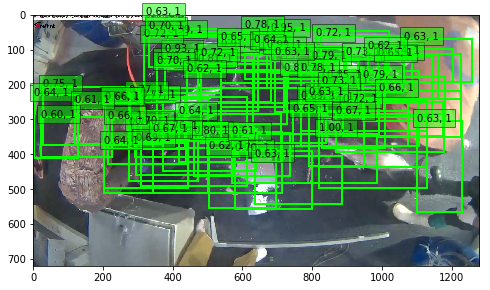

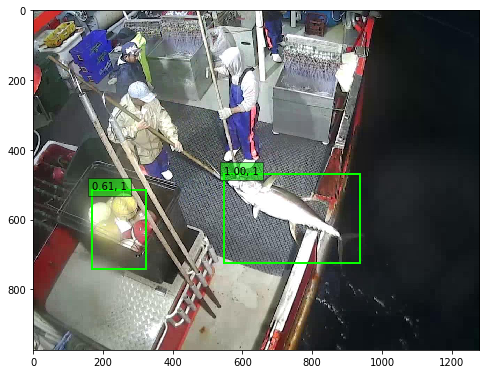

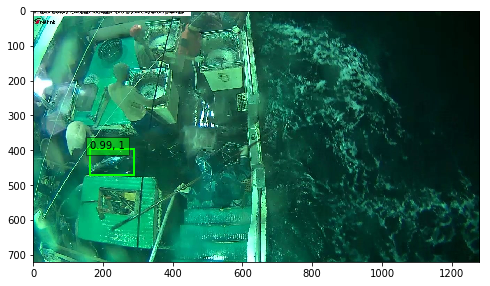

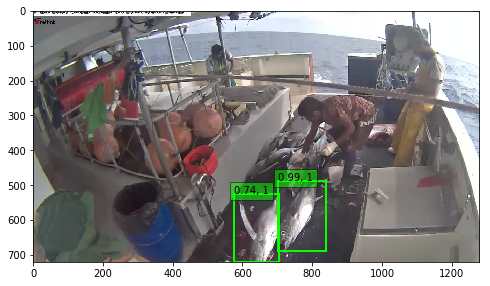

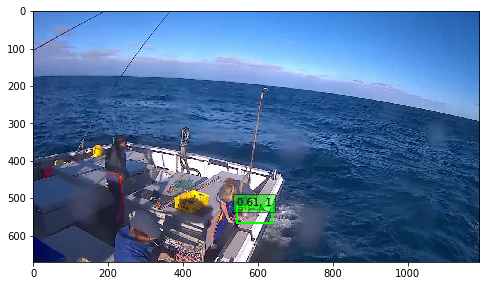

...

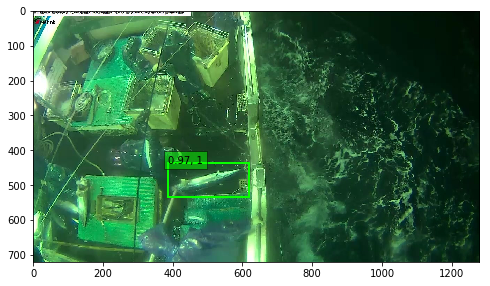

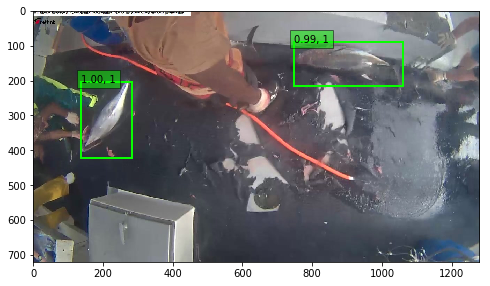

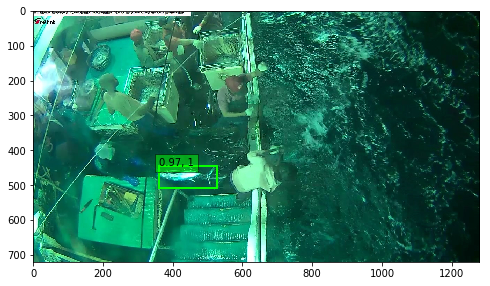

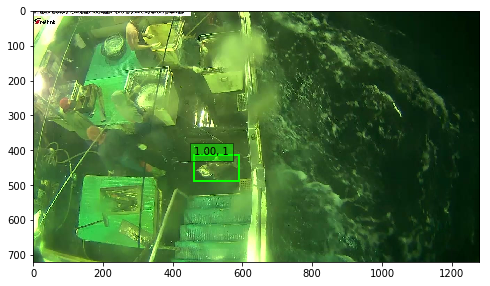

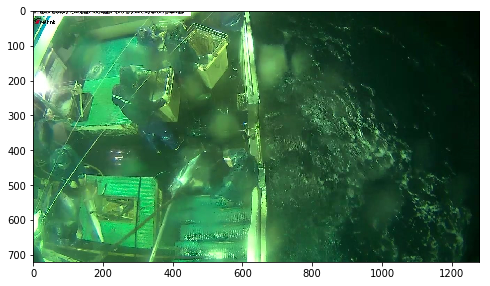

In [32]:
for i, img in enumerate(images):
    # Parse the outputs.
    det_label = results[i][:, 0]
    det_conf = results[i][:, 1]
    det_xmin = results[i][:, 2]
    det_ymin = results[i][:, 3]
    det_xmax = results[i][:, 4]
    det_ymax = results[i][:, 5]

    # Get detections with confidence higher than 0.6.
    top_indices = [i for i, conf in enumerate(det_conf) if conf >= 0.60]

    top_conf = det_conf[top_indices]
    top_label_indices = det_label[top_indices].tolist()
    top_xmin = det_xmin[top_indices]
    top_ymin = det_ymin[top_indices]
    top_xmax = det_xmax[top_indices]
    top_ymax = det_ymax[top_indices]

    colors = plt.cm.hsv(np.linspace(0, 1, 4)).tolist()

    plt.imshow(img / 255.)
    currentAxis = plt.gca()

    for i in range(top_conf.shape[0]):
        xmin = int(round(top_xmin[i] * img.shape[1]))
        ymin = int(round(top_ymin[i] * img.shape[0]))
        xmax = int(round(top_xmax[i] * img.shape[1]))
        ymax = int(round(top_ymax[i] * img.shape[0]))
        score = top_conf[i]
        label = int(top_label_indices[i])
#         label_name = voc_classes[label - 1]
        display_txt = '{:0.2f}, {}'.format(score, label)
        coords = (xmin, ymin), xmax-xmin+1, ymax-ymin+1
        color = colors[label]
        currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
        currentAxis.text(xmin, ymin, display_txt, bbox={'facecolor':color, 'alpha':0.5})
    
    plt.show()